In [39]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
import random
from datetime import timedelta
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.subplots import make_subplots
import calmap
import folium
from plotnine import *  #pip install pandas plotnine
import seaborn as sns



import warnings
warnings.filterwarnings('ignore')


from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()   

cnf, dth, rec, act = '#393e46', '#ff2e63', '#21bf73', '#fe9801' #colors : very dark grayish blue,vivid pink,strong cyan - lime green,vivid orange

**We use the OutputArea option because we want to display the plots as a whole and not have to scroll down to see the rest**

In [40]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999; 

<IPython.core.display.Javascript object>

In [41]:
pd.set_option('display.max_rows', 50) #to display the first 50 rows in a table

In [42]:
full_table = pd.read_csv('covid_19_clean_complete.csv', parse_dates=['Date']) #source : https://github.com/imdevskp/covid_19_jhu_data_web_scrap_and_cleaning
full_table.sample(10)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered
3247,Xinjiang,China,41.112900,85.240100,2020-02-03,24,0,0
21595,NaN,Trinidad and Tobago,10.691800,-61.222500,2020-04-12,113,8,16
11845,NaN,Zambia,-15.416700,28.283300,2020-03-06,0,0,0
26210,Shanghai,China,31.202000,121.449100,2020-04-30,652,7,0
8812,NaN,Equatorial Guinea,1.500000,10.000000,2020-02-24,0,0,0
13442,NaN,Mali,17.570692,-3.996166,2020-03-12,0,0,0
2365,NaN,Burundi,-3.373100,29.918900,2020-01-30,0,0,0
17044,NaN,Liberia,6.428100,-9.429500,2020-03-26,3,0,0
10710,NaN,Lithuania,55.169400,23.881300,2020-03-02,1,0,0
20058,NaN,South Sudan,6.877000,31.307000,2020-04-06,1,0,0


**Our dataset contains information about some cruise-ships that had active cases of Covid-19. We remove them from the dataset in order to make plotting the world map easier**

In [43]:
# ship rows
ship_rows = full_table['Province/State'].str.contains('Grand Princess') | full_table['Province/State'].str.contains('Diamond Princess') | full_table['Country/Region'].str.contains('Diamond Princess') | full_table['Country/Region'].str.contains('MS Zaandam')

# ship
ship = full_table[ship_rows]

# full table 
full_table = full_table[~(ship_rows)]

# Latest cases from the ships
ship_latest = ship[ship['Date']==max(ship['Date'])]

# ship_latest.style.background_gradient(cmap='Pastel1_r')

**We derive the number of active cases from the total of confirmed ones minus the recovered and the death cases and we replace 'Mainland China' with 'China'.**

In [44]:
full_table['Active'] = full_table['Confirmed'] - full_table['Deaths'] - full_table['Recovered']
full_table['Country/Region'] = full_table['Country/Region'].replace('Mainland China', 'China')

**We notice that there are a lot of Nan values in the Province column so we replace them with a space. Also we replace every other Nan value with a zero and make everything of type int (so as to help with plotting).**

In [45]:
# filling missing values 
full_table[['Province/State']] = full_table[['Province/State']].fillna('')
full_table[['Confirmed', 'Deaths', 'Recovered', 'Active']] = full_table[['Confirmed', 'Deaths', 'Recovered', 'Active']].fillna(0)

# fixing datatypes
full_table['Recovered'] = full_table['Recovered'].astype(int)

full_table.sample(20)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active
22678,,Laos,19.856270,102.495496,2020-04-16,19,0,0,19
22669,,Zambia,-15.416700,28.283300,2020-04-16,48,2,30,16
26286,,Lithuania,55.169400,23.881300,2020-04-30,1385,45,589,751
15694,,Gambia,13.443200,-15.310100,2020-03-21,1,0,0,1
26156,,Bangladesh,23.685000,90.356300,2020-04-30,7667,168,160,7339
3016,Reunion,France,-21.135100,55.247100,2020-02-02,0,0,0,0
5406,,Haiti,18.971200,-72.285200,2020-02-11,0,0,0,0
17342,,Philippines,13.000000,122.000000,2020-03-27,803,54,31,718
12312,Sint Maarten,Netherlands,18.042500,-63.054800,2020-03-08,0,0,0,0
12040,,Monaco,43.733300,7.416700,2020-03-07,1,0,0,1


**We group our data by date and country and we also accomodate for any future cases that will enter our dataframe**

In [46]:
# Grouped by day, country
full_grouped = full_table.groupby(['Date', 'Country/Region'])['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()

# new cases 
temp = full_grouped.groupby(['Country/Region', 'Date', ])['Confirmed', 'Deaths', 'Recovered']
temp = temp.sum().diff().reset_index()

mask = temp['Country/Region'] != temp['Country/Region'].shift(1)

temp.loc[mask, 'Confirmed'] = np.nan
temp.loc[mask, 'Deaths'] = np.nan
temp.loc[mask, 'Recovered'] = np.nan

# renaming columns
temp.columns = ['Country/Region', 'Date', 'New cases', 'New deaths', 'New recovered']

# merging new values
full_grouped = pd.merge(full_grouped, temp, on=['Country/Region', 'Date'])

# filling na with 0
full_grouped = full_grouped.fillna(0)

# fixing data types
cols = ['New cases', 'New deaths', 'New recovered']
full_grouped[cols] = full_grouped[cols].astype('int')

full_grouped['New cases'] = full_grouped['New cases'].apply(lambda x: 0 if x<0 else x)

full_grouped.head()


,Date,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,New deaths,New recovered
0,2020-01-22,Afghanistan,0,0,0,0,0,0,0
1,2020-01-22,Albania,0,0,0,0,0,0,0
2,2020-01-22,Algeria,0,0,0,0,0,0,0
3,2020-01-22,Andorra,0,0,0,0,0,0,0
4,2020-01-22,Angola,0,0,0,0,0,0,0


**We group the data by day  and we make some new columns for the data, Deaths per 100 cases, Recovered per 100 cases and Deaths per 100 recovered**

In [47]:
# Day wise

# table
day_wise = full_grouped.groupby('Date')['Confirmed', 'Deaths', 'Recovered', 'Active', 'New cases'].sum().reset_index()

# number cases per 100 cases
day_wise['Deaths / 100 Cases'] = round((day_wise['Deaths']/day_wise['Confirmed'])*100, 2)
day_wise['Recovered / 100 Cases'] = round((day_wise['Recovered']/day_wise['Confirmed'])*100, 2)
day_wise['Deaths / 100 Recovered'] = round((day_wise['Deaths']/day_wise['Recovered'])*100, 2)

# no. of countries
day_wise['No. of countries'] = full_grouped[full_grouped['Confirmed']!=0].groupby('Date')['Country/Region'].unique().apply(len).values

# fillna by 0
cols = ['Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered']
day_wise[cols] = day_wise[cols].fillna(0)

day_wise.head()

,Date,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,No. of countries
0,2020-01-22,555,17,28,510,0,3.06,5.05,60.71,6
1,2020-01-23,654,18,30,606,99,2.75,4.59,60.00,8
2,2020-01-24,941,26,35,880,287,2.76,3.72,74.29,9
3,2020-01-25,1434,42,38,1354,493,2.93,2.65,110.53,11
4,2020-01-26,2118,56,51,2011,684,2.64,2.41,109.80,13


**We group the data by country, getting the latest values while also making the same columns like in the day_wise table**

In [48]:
# Country wise

# getting latest values
country_wise = full_grouped[full_grouped['Date']==max(full_grouped['Date'])].reset_index(drop=True).drop('Date', axis=1)

# group by country
country_wise = country_wise.groupby('Country/Region')['Confirmed', 'Deaths', 'Recovered', 'Active', 'New cases'].sum().reset_index()

# per 100 cases
country_wise['Deaths / 100 Cases'] = round((country_wise['Deaths']/country_wise['Confirmed'])*100, 2)
country_wise['Recovered / 100 Cases'] = round((country_wise['Recovered']/country_wise['Confirmed'])*100, 2)
country_wise['Deaths / 100 Recovered'] = round((country_wise['Deaths']/country_wise['Recovered'])*100, 2)

cols = ['Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered']
country_wise[cols] = country_wise[cols].fillna(0)

country_wise.head()

,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered
0,Afghanistan,2171,64,260,1847,232,2.95,11.98,24.62
1,Albania,773,31,470,272,7,4.01,60.80,6.60
2,Algeria,4006,450,1779,1777,158,11.23,44.41,25.30
3,Andorra,745,42,468,235,2,5.64,62.82,8.97
4,Angola,27,2,7,18,0,7.41,25.93,28.57


**Now we want to make a Cases per million people column for the country table so we load a population dataset, adding some countries population that was missing from it**

In [49]:
# load population dataset
pop = pd.read_csv("population_by_country_2020.csv") #source: https://www.kaggle.com/tanuprabhu/population-by-country-2020

# select only population
pop = pop.iloc[:, :2]

# rename column names
pop.columns = ['Country/Region', 'Population']

# merged data
country_wise = pd.merge(country_wise, pop, on='Country/Region', how='left')

# update population
cols = ['Burma', 'Congo (Brazzaville)', 'Congo (Kinshasa)', "Cote d'Ivoire", 'Czechia', 
        'Kosovo', 'Saint Kitts and Nevis', 'Saint Vincent and the Grenadines', 
        'Taiwan*', 'US', 'West Bank and Gaza']
pops = [54409800, 89561403, 5518087, 26378274, 10708981, 1793000, 
        53109, 110854, 23806638, 330541757, 4543126]
for c, p in zip(cols, pops):
    country_wise.loc[country_wise['Country/Region']== c, 'Population'] = p
    


# Cases per population
country_wise['Cases / Million People'] = round((country_wise['Confirmed'] / country_wise['Population']) * 1000000)

country_wise.head()


,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population,Cases / Million People
0,Afghanistan,2171,64,260,1847,232,2.95,11.98,24.62,38742911.0,56.0
1,Albania,773,31,470,272,7,4.01,60.80,6.60,2878420.0,269.0
2,Algeria,4006,450,1779,1777,158,11.23,44.41,25.30,43685618.0,92.0
3,Andorra,745,42,468,235,2,5.64,62.82,8.97,77240.0,9645.0
4,Angola,27,2,7,18,0,7.41,25.93,28.57,32644783.0,1.0


**We add three new columns to the country_wise table, the confirmed cases as of 1 week ago and the difference between last week's cases and this week's in numbers and in percentage.**

In [50]:
today = full_grouped[full_grouped['Date']==max(full_grouped['Date'])].reset_index(drop=True).drop('Date', axis=1)[['Country/Region', 'Confirmed']]
# With the max function we take the latest Date (which is today)

# Timedelta is a datetime library function that gives us the correct delay in time (7 days ie 1 week ago)
last_week = full_grouped[full_grouped['Date']==max(full_grouped['Date'])-timedelta(days=7)].reset_index(drop=True).drop('Date', axis=1)[['Country/Region', 'Confirmed']]

temp = pd.merge(today, last_week, on='Country/Region', suffixes=(' today', ' last week'))

# temp = temp[['Country/Region', 'Confirmed last week']]

temp['1 week change'] = temp['Confirmed today'] - temp['Confirmed last week']

temp = temp[['Country/Region', 'Confirmed last week', '1 week change']]

country_wise = pd.merge(country_wise, temp, on='Country/Region')

country_wise['1 week % increase'] = round(country_wise['1 week change']/country_wise['Confirmed last week']*100, 2)

country_wise.head()


,Country/Region,Confirmed,Deaths,Recovered,Active,New cases,Deaths / 100 Cases,Recovered / 100 Cases,Deaths / 100 Recovered,Population,Cases / Million People,Confirmed last week,1 week change,1 week % increase
0,Afghanistan,2171,64,260,1847,232,2.95,11.98,24.62,38742911.0,56.0,1279,892,69.74
1,Albania,773,31,470,272,7,4.01,60.80,6.60,2878420.0,269.0,663,110,16.59
2,Algeria,4006,450,1779,1777,158,11.23,44.41,25.30,43685618.0,92.0,3007,999,33.22
3,Andorra,745,42,468,235,2,5.64,62.82,8.97,77240.0,9645.0,723,22,3.04
4,Angola,27,2,7,18,0,7.41,25.93,28.57,32644783.0,1.0,25,2,8.00


**We use the pandas function melt to make the dataframe (with the latest data) into a format where the 'Date' column is an identifier variable (id_vars), while all other columns ('Active','Deaths','Recovered'), considered measured variables (value_vars), are “unpivoted” to the row axis, leaving just two non-identifier columns, ‘variable’ and ‘value’. <br> We use Plotly Express library's treemap function to plot the data.**

In [51]:
temp = full_table.groupby('Date')['Confirmed', 'Deaths', 'Recovered', 'Active'].sum().reset_index()
temp = temp[temp['Date']==max(temp['Date'])].reset_index(drop=True)

tm = temp.melt(id_vars="Date", value_vars=['Active', 'Deaths', 'Recovered'])
fig = px.treemap(tm, path=["variable"], values="value", height=225, width=1150,
                 color_discrete_sequence=[act, rec, dth])
fig.data[0].textinfo = 'label+text+value'
fig.show()

**We want to plot cases over time so we make a new temp table to hold the case count and again use melt()**

In [52]:
temp = full_table.groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
temp = temp.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
temp.head()

,Date,Case,Count
0,2020-01-22,Recovered,28
1,2020-01-23,Recovered,30
2,2020-01-24,Recovered,35
3,2020-01-25,Recovered,38
4,2020-01-26,Recovered,51


**We use Plotly Express' area function to create a filled area plot with cases over time**

In [53]:
fig = px.area(temp, x="Date", y="Count", color='Case', height=600,
             title='Cases over time', color_discrete_sequence = [rec, dth, act])
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

**We plot the cases on the world map using Folium's map function('pip install calmap' and 'pip install folium' on the Anaconda Prompt). The size of the circle on each country depends on the number of confirmed cases in that country.**

In [54]:
# World wide

temp = full_table[full_table['Date'] == max(full_table['Date'])]

m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=8, zoom_start=1)

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Lat'], temp.iloc[i]['Long']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country/Region'])+
                    '<li><bold>Province : '+str(temp.iloc[i]['Province/State'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['Confirmed'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Deaths']),
        radius=int(temp.iloc[i]['Confirmed'])**1.1).add_to(m)
m

**Using the full_grouped table (cases for every country and every available date) we make this animation of how the cases progressed with time. A Choropleth Map is a map composed of colored polygons. It is used to represent spatial variations of a quantity.**

In [55]:
fig = px.choropleth(full_grouped, locations="Country/Region", locationmode='country names', color=np.log(full_grouped["Confirmed"]), 
                    hover_name="Country/Region", animation_frame=full_grouped["Date"].dt.strftime('%Y-%m-%d'),
                    title='Cases over time', color_continuous_scale=px.colors.sequential.Magenta)
fig.update(layout_coloraxis_showscale=False)
fig.show()

**We do the same (without the animation effect because this table doesn't hold dates) for the confirmed cases and the deaths from the country_wise table and combine them into a plot**

In [56]:
# Confirmed
fig_c = px.choropleth(country_wise, locations="Country/Region", locationmode='country names', 
                      color=np.log(country_wise["Confirmed"]), hover_name="Country/Region", hover_data=['Confirmed'])

# Deaths
temp = country_wise[country_wise['Deaths']>0]
fig_d = px.choropleth(temp, locations="Country/Region", locationmode='country names',
                      color=np.log(temp["Deaths"]), hover_name="Country/Region", hover_data=['Deaths'])

# Plot
fig = make_subplots(rows=1, cols=2, subplot_titles = ['Confirmed', 'Deaths'],
                    specs=[[{"type": "choropleth"}, {"type": "choropleth"}]])

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)

fig.update(layout_coloraxis_showscale=False)

fig.show()


**Using  the day_wise table we make 2 bar plots , one with the confirmed cases vs the date , and the other with the deaths vs the date. <br> We also make 3 line plots with the Deaths per 100 cases , the Recovered per 100 cases and the Deaths per 100 Recovered.<br> Lastly we make 2 bar plots with the Number of new cases everyday and the number of countries that have patients.**

In [57]:
fig_c = px.bar(day_wise, x="Date", y="Confirmed", color_discrete_sequence = [act])
fig_d = px.bar(day_wise, x="Date", y="Deaths", color_discrete_sequence = [dth])

fig = make_subplots(rows=1, cols=2, shared_xaxes=False, horizontal_spacing=0.1,
                    subplot_titles=('Confirmed cases', 'Deaths reported'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)

fig.update_layout(height=480)
fig.show()

# ===============================

fig_1 = px.line(day_wise, x="Date", y="Deaths / 100 Cases", color_discrete_sequence = [dth])
fig_2 = px.line(day_wise, x="Date", y="Recovered / 100 Cases", color_discrete_sequence = [rec])
fig_3 = px.line(day_wise, x="Date", y="Deaths / 100 Recovered", color_discrete_sequence = ['#333333'])

fig = make_subplots(rows=1, cols=3, shared_xaxes=False, 
                    subplot_titles=('Deaths / 100 Cases', 'Recovered / 100 Cases', 'Deaths / 100 Recovered'))

fig.add_trace(fig_1['data'][0], row=1, col=1)
fig.add_trace(fig_2['data'][0], row=1, col=2)
fig.add_trace(fig_3['data'][0], row=1, col=3)

fig.update_layout(height=480)
fig.show()

# ===================================

fig_c = px.bar(day_wise, x="Date", y="New cases", color_discrete_sequence = [act])
fig_d = px.bar(day_wise, x="Date", y="No. of countries", color_discrete_sequence = [dth])

fig = make_subplots(rows=1, cols=2, shared_xaxes=False, horizontal_spacing=0.1,
                    subplot_titles=('No. of new cases everyday', 'No. of countries'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)

fig.update_layout(height=480)
fig.show()


**Some more bar plots with some insightful data**

In [58]:
# confirmed - deaths
fig_c = px.bar(country_wise.sort_values('Confirmed').tail(15), x="Confirmed", y="Country/Region", 
               text='Confirmed', orientation='h', color_discrete_sequence = [act])
fig_d = px.bar(country_wise.sort_values('Deaths').tail(15), x="Deaths", y="Country/Region", 
               text='Deaths', orientation='h', color_discrete_sequence = [dth])

# recovered - active
fig_r = px.bar(country_wise.sort_values('Recovered').tail(15), x="Recovered", y="Country/Region", 
               text='Recovered', orientation='h', color_discrete_sequence = [rec])
fig_a = px.bar(country_wise.sort_values('Active').tail(15), x="Active", y="Country/Region", 
               text='Active', orientation='h', color_discrete_sequence = ['#333333'])

# death - recovered / 100 cases
fig_dc = px.bar(country_wise.sort_values('Deaths / 100 Cases').tail(15), x="Deaths / 100 Cases", y="Country/Region", 
               text='Deaths / 100 Cases', orientation='h', color_discrete_sequence = ['#f38181'])
fig_rc = px.bar(country_wise.sort_values('Recovered / 100 Cases').tail(15), x="Recovered / 100 Cases", y="Country/Region", 
               text='Recovered / 100 Cases', orientation='h', color_discrete_sequence = ['#a3de83'])

# new cases - cases per million people
fig_nc = px.bar(country_wise.sort_values('New cases').tail(15), x="New cases", y="Country/Region", 
               text='New cases', orientation='h', color_discrete_sequence = ['#c61951'])
temp = country_wise[country_wise['Population']>1000000] # Because some countries with population less than one million might show up
fig_p = px.bar(temp.sort_values('Cases / Million People').tail(15), x="Cases / Million People", y="Country/Region", 
               text='Cases / Million People', orientation='h', color_discrete_sequence = ['#741938'])

# week change, percent increase
fig_wc = px.bar(country_wise.sort_values('1 week change').tail(15), x="1 week change", y="Country/Region", 
               text='1 week change', orientation='h', color_discrete_sequence = ['#004a7c'])
temp = country_wise[country_wise['Confirmed']>100] # Because some countries with less than 100 confirmed cases might show up
fig_pi = px.bar(temp.sort_values('1 week % increase').tail(15), x="1 week % increase", y="Country/Region", 
               text='1 week % increase', orientation='h', color_discrete_sequence = ['#005691'], 
                hover_data=['Confirmed last week', 'Confirmed'])


# plot
fig = make_subplots(rows=5, cols=2, shared_xaxes=False, horizontal_spacing=0.14, vertical_spacing=0.08,
                    subplot_titles=('Confirmed cases', 'Deaths reported', 'Recovered', 'Active cases', 
                                    'Deaths / 100 cases', 'Recovered / 100 cases', 'New cases', 
                                    'Cases / Million People', '1 week increase', '1 week % increase'))

fig.add_trace(fig_c['data'][0], row=1, col=1)
fig.add_trace(fig_d['data'][0], row=1, col=2)
fig.add_trace(fig_r['data'][0], row=2, col=1)
fig.add_trace(fig_a['data'][0], row=2, col=2)

fig.add_trace(fig_dc['data'][0], row=3, col=1)
fig.add_trace(fig_rc['data'][0], row=3, col=2)
fig.add_trace(fig_nc['data'][0], row=4, col=1)
fig.add_trace(fig_p['data'][0], row=4, col=2)

fig.add_trace(fig_wc['data'][0], row=5, col=1)
fig.add_trace(fig_pi['data'][0], row=5, col=2)


fig.update_layout(height=3000)


**We make a scatter plot of the deaths vs confirmed cases  on a logarithmic scale**

In [59]:
fig = px.scatter(country_wise.sort_values('Deaths', ascending=False).iloc[:15, :], 
                 x='Confirmed', y='Deaths', color='Country/Region', size='Confirmed', height=700,
                 text='Country/Region', log_x=True, log_y=True, title='Deaths vs Confirmed (Scale is in log10)')
fig.update_traces(textposition='top center')
fig.update_layout(showlegend=False)

fig.show()


**Line plots showing the confirmed / dead / new cases per country and per date ( we could also do bar plots for the same information but it caused too much 'lagging' and also the information is a bit redundant).**

In [60]:
fig = px.line(full_grouped, x="Date", y="Confirmed", color='Country/Region', height=600,
             title='Confirmed', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.update_layout(showlegend=False)
fig.show()

# =========================================

fig = px.line(full_grouped, x="Date", y="Deaths", color='Country/Region', height=600,
             title='Deaths', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.update_layout(showlegend=False)
fig.show()

# =========================================

fig = px.line(full_grouped, x="Date", y="New cases", color='Country/Region', height=600,
             title='New cases', color_discrete_sequence = px.colors.cyclical.mygbm)
fig.update_layout(showlegend=False)
fig.show()


**We make these line plots to show how the confirmed case number grew after it reached  100 , 1000 , and 10000**

In [61]:
gt_100 = full_grouped[full_grouped['Confirmed']>100]['Country/Region'].unique()
temp = full_table[full_table['Country/Region'].isin(gt_100)]
temp = temp.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()
temp = temp[temp['Confirmed']>100]


min_date = temp.groupby('Country/Region')['Date'].min().reset_index()
min_date.columns = ['Country/Region', 'Min Date']


from_100th_case = pd.merge(temp, min_date, on='Country/Region')
from_100th_case['N days'] = (from_100th_case['Date'] - from_100th_case['Min Date']).dt.days


fig = px.line(from_100th_case, x='N days', y='Confirmed', color='Country/Region', title='N days from 100 case', height=600)
fig.update_layout(showlegend=False)
fig.show()

# ===========================================================================

gt_1000 = full_grouped[full_grouped['Confirmed']>1000]['Country/Region'].unique()
temp = full_table[full_table['Country/Region'].isin(gt_1000)]
temp = temp.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()
temp = temp[temp['Confirmed']>1000]


min_date = temp.groupby('Country/Region')['Date'].min().reset_index()
min_date.columns = ['Country/Region', 'Min Date']


from_1000th_case = pd.merge(temp, min_date, on='Country/Region')
from_1000th_case['N days'] = (from_1000th_case['Date'] - from_1000th_case['Min Date']).dt.days


fig = px.line(from_1000th_case, x='N days', y='Confirmed', color='Country/Region', title='N days from 1000 case', height=600)
fig.update_layout(showlegend=False)
fig.show()

# ===========================================================================

gt_10000 = full_grouped[full_grouped['Confirmed']>10000]['Country/Region'].unique()
temp = full_table[full_table['Country/Region'].isin(gt_10000)]
temp = temp.groupby(['Country/Region', 'Date'])['Confirmed'].sum().reset_index()
temp = temp[temp['Confirmed']>10000]


min_date = temp.groupby('Country/Region')['Date'].min().reset_index()
min_date.columns = ['Country/Region', 'Min Date']


from_10000th_case = pd.merge(temp, min_date, on='Country/Region')
from_10000th_case['N days'] = (from_10000th_case['Date'] - from_10000th_case['Min Date']).dt.days


fig = px.line(from_10000th_case, x='N days', y='Confirmed', color='Country/Region', title='N days from 10000 case', height=600)
fig.update_layout(showlegend=False)
fig.show()


**Two treemaps showing the number of confirmed cases and deaths per country according to the latest data**

In [62]:
full_latest = full_table[full_table['Date'] == max(full_table['Date'])]
                         
fig = px.treemap(full_latest.sort_values(by='Confirmed', ascending=False).reset_index(drop=True), 
                 path=["Country/Region", "Province/State"], values="Confirmed", height=700,
                 title='Number of Confirmed Cases',
                 color_discrete_sequence = px.colors.qualitative.Dark2)
fig.data[0].textinfo = 'label+text+value'
fig.show()

fig = px.treemap(full_latest.sort_values(by='Deaths', ascending=False).reset_index(drop=True), 
                 path=["Country/Region", "Province/State"], values="Deaths", height=700,
                 title='Number of Deaths reported',
                 color_discrete_sequence = px.colors.qualitative.Dark2)
fig.data[0].textinfo = 'label+text+value'
fig.show()

**Scatter plot showing the new cases per country**

In [63]:
temp = full_grouped[full_grouped['New cases']>0].sort_values('Country/Region', ascending=False)
fig = px.scatter(temp, x='Date', y='Country/Region', size='New cases', color='New cases', height=3000, 
           color_continuous_scale=px.colors.sequential.Viridis)
fig.update_layout(yaxis = dict(dtick = 1))
fig.update(layout_coloraxis_showscale=False)
fig.show()

**Heatmap showing how the active case number progressed for each country (indicative of their efforts to fight the disease)**

In [64]:
fig = go.Figure(data=go.Heatmap(
        z=full_grouped['Active'],
        x=full_grouped['Date'],
        y=full_grouped['Country/Region'],
        colorscale='Reds',
        showlegend=False,
        text=full_grouped['Active']))

fig.update_layout(yaxis = dict(dtick = 1))
fig.update_layout(height=3000)
fig.show()

**Bar plots to show the number of new cases in each country**

In [65]:
temp = full_table.groupby(['Country/Region', 'Date', ])['Confirmed', 'Deaths']
temp = temp.sum().diff().reset_index()

mask = temp['Country/Region'] != temp['Country/Region'].shift(1)

temp.loc[mask, 'Confirmed'] = np.nan
temp.loc[mask, 'Deaths'] = np.nan

countries = ['Greece','China', 'Iran', 'South Korea', 'Italy', 'France', 'Germany', 'Spain', 'US']

n_cols = 4
n_rows = 3
fig = make_subplots(rows=n_rows, cols=n_cols, shared_xaxes=False, subplot_titles=countries)

for ind, country in enumerate(countries):
    row = int((ind/n_cols)+1)
    col = int((ind%n_cols)+1)
    fig.add_trace(go.Bar(x=temp['Date'], y=temp.loc[temp['Country/Region']==country, 'Confirmed'], name=country), row=row, col=col)
    
fig.update_layout(height=2000, title_text="No. of new cases in each Country")    
fig.show()


**We want to compare COVID-19 to other pandemics**

In [66]:
pandemics = pd.DataFrame({
    'pandemic' : ['COVID-19', 'SARS', 'EBOLA', 'MERS', 'H1N1'],
    'start_year' : [2019, 2003, 2014, 2012, 2009],
    'end_year' : [2020, 2004, 2016, 2017, 2010],
    'confirmed' : [full_latest['Confirmed'].sum(), 8096, 28646, 2494, 6724149],
    'deaths' : [full_latest['Deaths'].sum(), 774, 11323, 858, 19654]
})

pandemics['mortality'] = round((pandemics['deaths']/pandemics['confirmed'])*100, 2)

pandemics

,pandemic,start_year,end_year,confirmed,deaths,mortality
0,COVID-19,2019,2020,3256107,233372,7.17
1,SARS,2003,2004,8096,774,9.56
2,EBOLA,2014,2016,28646,11323,39.53
3,MERS,2012,2017,2494,858,34.40
4,H1N1,2009,2010,6724149,19654,0.29


In [67]:
temp = pandemics.melt(id_vars='pandemic', value_vars=['confirmed', 'deaths', 'mortality'],
                      var_name='Case', value_name='Value')

fig = px.bar(temp, x="pandemic", y="Value", color='pandemic', text='Value', facet_col="Case",
             color_discrete_sequence = px.colors.qualitative.Bold)
fig.update_traces(textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.update_yaxes(showticklabels=False)
fig.layout.yaxis2.update(matches=None)
fig.layout.yaxis3.update(matches=None)
fig.show()

**We try to visualize some data from individual patient cases.**

In [68]:
master_df = pd.read_csv("master_dataset.csv",index_col=False)    #source : https://www.covid19survivalcalculator.com/en/download
master_df

,survey_date,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,...,lung_disease,diabetes,hiv_positive,hypertension,other_chronic,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality
0,2020-03-25,NaN,CA,43.6203,-79.3394,100.0,male,20_30,178,88,...,0,0,0,0,0,NaN,NaN,NaN,9.000,0.500
1,2020-03-25,NaN,CA,43.2780,-79.8436,100.0,male,80_90,184,94,...,1,1,0,1,0,NaN,NaN,NaN,9.000,64.824
2,2020-03-25,NaN,CA,51.1308,-114.1161,5.0,female,30_40,158,54,...,0,0,0,0,0,NaN,NaN,NaN,9.000,0.500
3,2020-03-26,NaN,CA,45.6257,-73.7010,5.0,male,60_70,172,96,...,0,1,0,1,0,NaN,NaN,NaN,9.000,21.658
4,2020-03-26,NaN,CA,48.4394,-123.4072,1.0,female,50_60,166,82,...,0,0,0,0,1,NaN,NaN,NaN,9.000,12.061
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
682788,2020-04-18,NaN,US,41.2835,-95.9222,200.0,female,30_40,170,160,...,0,0,0,1,1,ALPRAZOLAM;AMPHETAMINE ASPARTATE;AMPHETAMINE S...,85.0,65.0,95.000,7.243
682789,2020-04-18,NaN,US,37.6398,-121.0929,5.0,female,50_60,176,110,...,0,0,0,1,0,HYDROCHLOROTHIAZIDE;NAPROXEN,25.0,5.0,28.999,10.140
682790,2020-04-19,SA,AR,-34.6802,-58.5302,5.0,female,40_50,152,44,...,0,0,0,0,0,NaN,15.0,15.0,28.000,0.637
682791,2020-04-19,EU,NO,59.9596,10.7746,1.0,male,50_60,190,94,...,0,0,0,0,0,NaN,15.0,25.0,31.000,1.396


In [69]:
master_df["age"].replace({"0_10":"5","10_20": "15","20_30":"25","30_40":"35","40_50": "45","50_60":"55","60_70":"65","70_80":"75","80_90":'85',"90_100":'95',"100_110":"105"}, inplace=True)
master_df['age'] = master_df['age'].astype(int)
master_df['age_by_decade'] = pd.cut(x=master_df['age'], bins=[0,9,19, 29, 39, 49,59,69,79,89,99,110], labels=['0s','10s','20s', '30s', '40s','50s','60s','70s','80s','90s','100s'])

**We pick out the people who are actually COVID-19 positive.**

In [70]:
master_df_cases = master_df.loc[master_df['covid19_positive'] == 1]
master_df_cases

,survey_date,region,country,ip_latitude,ip_longitude,ip_accuracy,sex,age,height,weight,...,diabetes,hiv_positive,hypertension,other_chronic,prescription_medication,opinion_infection,opinion_mortality,risk_infection,risk_mortality,age_by_decade
10,2020-03-26,NaN,US,33.8474,-118.1465,500.0,male,55,184,80,...,0,0,0,0,NaN,NaN,NaN,100.0,1.297,50s
24,2020-03-25,EU,NL,52.0501,4.4706,5.0,female,85,164,84,...,0,0,1,0,NaN,NaN,NaN,100.0,14.531,80s
2571,2020-04-04,NaN,US,35.5152,-78.8872,20.0,male,65,192,118,...,1,0,1,0,NaN,NaN,NaN,100.0,28.544,60s
2976,2020-04-05,NaN,US,40.2036,-87.6647,5.0,male,35,186,114,...,0,0,0,0,NaN,95.0,25.0,100.0,0.500,30s
3784,2020-04-05,NaN,US,38.9913,-77.4867,10.0,female,45,168,54,...,0,0,0,0,NaN,15.0,5.0,100.0,0.500,40s
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
681635,2020-04-11,SA,BR,-22.6623,-47.8625,10.0,male,105,134,90,...,0,0,1,0,NaN,95.0,95.0,100.0,82.354,100s
681704,2020-04-11,SA,BR,-3.1465,-60.0646,50.0,male,35,160,68,...,0,0,0,0,NaN,95.0,5.0,100.0,0.500,30s
681791,2020-04-11,SA,BR,-22.8138,-43.1365,1000.0,male,35,164,60,...,0,0,0,0,NaN,85.0,5.0,100.0,0.500,30s
682119,2020-04-14,SA,BR,-21.7230,-43.3471,500.0,male,25,170,68,...,0,0,0,0,NaN,55.0,15.0,100.0,0.500,20s


sex
female    AxesSubplot(0.125,0.125;0.775x0.755)
male      AxesSubplot(0.125,0.125;0.775x0.755)
other     AxesSubplot(0.125,0.125;0.775x0.755)
Name: age, dtype: object

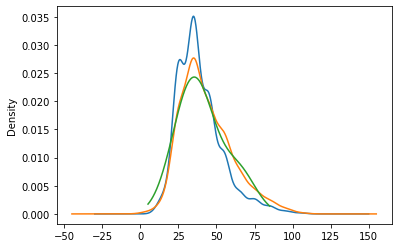

In [71]:
master_df_cases.groupby('sex').age.plot(kind='kde')

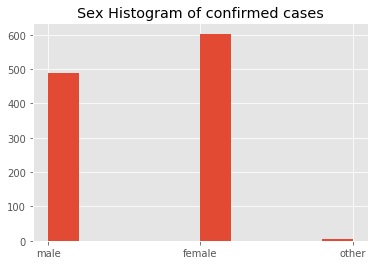

In [72]:
plt.style.use('ggplot')

master_df_cases_sex = master_df_cases['sex']
plt.hist(master_df_cases_sex)
plt.title("Sex Histogram of confirmed cases")
plt.show()

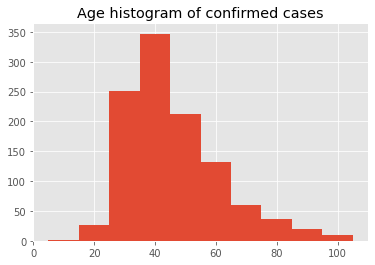

In [73]:
master_df_cases_age = master_df_cases['age'].sort_values()
plt.hist(master_df_cases_age)
plt.title('Age histogram of confirmed cases')
plt.show()

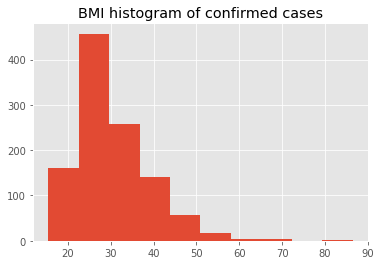

In [74]:
master_df_cases_bmi = master_df_cases['bmi']
plt.hist(master_df_cases_bmi)
plt.title('BMI histogram of confirmed cases')
plt.show()

**Concerning the peoples' opinion about the actions of the government ,-2 is very negative , 0 is neutral , 2 is very positive. The questions are : <br>
My government is taking COVID-19 seriously. <br>
I think my government should enforce social isolation. <br>
I think my government should spend money to help people and businesses affected by COVID-19.**

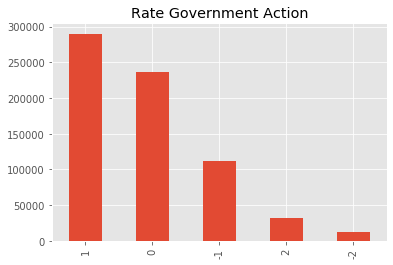

In [75]:
master_df_opinion = master_df['rate_government_action']
pd.value_counts(master_df_opinion).plot(kind="bar")
plt.title('Rate Government Action')
plt.show()

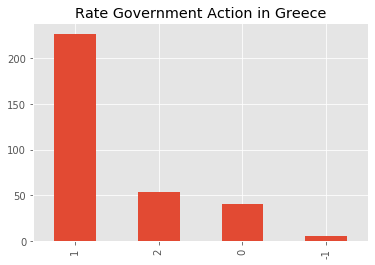

In [76]:
master_df_GR = master_df.loc[master_df['country'] == 'GR']
master_df_GR_opinion = master_df_GR['rate_government_action']
pd.value_counts(master_df_GR_opinion).plot(kind="bar")
plt.title('Rate Government Action in Greece')
plt.show()